# Model Predictive Control
## What is Model Predictive Control?
Model Predictive Control (MPC) is an optimal control technique, where the control inputs are designed with an objective to minimize a cost to achieve the desired states of a constrained dynamical system over a finite, receding horizon. MPC optimizes the control inputs by predicting the future states using a predefined dynamical model of the system and evaluating the costs and the constraints for the predicted states.

![MPC: The dotted line represents the predicted states, the continuous lines represent measured states after applying the control inputs. Source: *do-mpc.com*](https://www.do-mpc.com/en/latest/_images/anim.gif)

## Advantages of MPC over PID
1. Optimal performance over a horizon.
2. Explicit constraint handling.
3. Suitable for nonlinear systems.

## MPC in Robotics
MPC is popularly used in robotics because robotics systems operate in dynamic, constrained, and uncertain environments. MPC provides optimal control inputs that balances between **fast navigation**, **constraint adherence** (such as **collision avoidance** and actuator liimits), and **minimal control efforts**. Some common applications are:
1. UAV Navigation
2. Multi-Agent Collision Avoidance
3. Cruise Control

## MPC Implementation:
1. Build the model using the dynamics.
2. Using the desired current and future states, build an objective function, whose cost decreases as the measured states approach the desired states.
3. Impose the state and input constraints to the model.
4. Optimize the control inputs by predicting the future states by applying the current measured states and control inputs on the system's dynamic model, and imposing the constraints.
5. From the generated set of control values, apply the first control input to the robot.
6. As the robot responds to the control values, update the measured states and continue the optimization (from Step 4).
---


## MPC Terminologies


### Cost Function / Objective Function

* **Definition:** A function that the MPC minimizes to achieve desired behavior.
* **Common Form:**

$$
J = \sum_{k=0}^{N_p-1} \big( \underbrace{(x_k-x_k^d)^\top Q (x_k - x_k^d))}_{Lagrange-term} + \underbrace{\Delta u_k^\top R \Delta u_k}_{smoothness} + \underbrace{u_k^\top R^* u_k}_{effort} \big) + \underbrace{(x_{N_p} - x_{N_p}^d)^\top P (x_{N_p} - x_{N_p}^d)}_{Meyer-term}
$$

where $x_k$ = measured state, $x_k^d$ = desired state, $u_k$ = control input, $Q$ = state weight, $R*$ = smoothness weight, $R*$ = control weight, $P$ = terminal weight.

* **Purpose:** Penalizes deviation from reference trajectory and excessive control effort.


### Prediction Horizon ($N_p$)

* **Definition:** The number of future time steps over which the MPC predicts the system behavior.
* **Purpose:** Determines how far into the future the controller “looks” to optimize performance.
* **Example:** $N_p = 10$ means the controller predicts 10 steps ahead.


### Control Horizon ($N_c$)

* **Definition:** The number of future control inputs that the MPC optimizes. Often $N_c \leq N_p$.
* **Purpose:** Reduces computational load by limiting the number of decision variables.
* **Example:** If $N_c = 3$, only the next 3 control actions are optimized, while the rest ($u_{N_c+1} -- u_{N_p}$ take the final value $u_{N_c}$.


### Constraints

* **Definition:** Limits on states or control inputs to keep the system safe or feasible.

* **Types:**

  * **Input constraints:** $u_{\min} \leq u \leq u_{\max}$
  * **State constraints:** $x_{\min} \leq x \leq x_{\max}$
  * **Mixed constraints:** Functions involving both $x$ and $u$

* **Purpose:** Ensures real-world limitations (e.g., actuator saturation, safety boundaries) are respected.
* **Note:** Hard constraints must never be violated. Soft constraints are relatively weak, which can be violated with a high cost.


### Prediction Model/Dynamical Model

* **Definition:** Mathematical model that predicts future system states based on current state and control inputs.
* **Types:**

  * **Linear:** $x_{k+1} = A x_k + B u_k$
  * **Nonlinear:** $x_{k+1} = f(x_k, u_k)$
* **Purpose:** MPC relies on this model to forecast the effect of control actions.

### Receding Horizon / Moving Horizon

* **Definition:** At each control step, MPC solves the optimization problem for the horizon but applies **only the first control input**. Then the horizon moves forward.
* **Purpose:** Allows MPC to adapt to disturbances and model mismatches in real-time.

### Terminal Cost & Terminal Constraint

* **Terminal cost ($x_{N_p}^\top P x_{N_p}$)**: Encourages the system to end close to the desired state at the end of the horizon.
* **Terminal constraint:** Optional condition to ensure stability (e.g., $x_{N_p} \in \text{admissible set}$).

### Online Optimization

* **Definition:** MPC solves an optimization problem **at every control step** using the latest state measurement.
* **Key Feature:** Makes MPC computationally intensive but highly adaptive.

---

## Example: Single Integrator System
Let us take an example of a first-order linear dynamic system with two states, $x$ and $y$, and two control inputs $v_x$ and $v_y$.
### Dynamic/Kinematic Model:
$$
\begin{bmatrix}
\dot{x} \\ \dot{y}
\end{bmatrix}  = \begin{bmatrix}
v_x \\ v_y
\end{bmatrix}
$$

The control inputs directly appear in the first-derivative of the states $x,y$ here. Now, let us choose our goal to be $x_d = 5.0, y_d = 3.5$ and form the cost function.

$$
J = \sum_{k=0}^{19} \Big(  10 \big((x_k-5.0)^2 + (y_k - 3.5)^2 \big) + 0.01 \big(\Delta v_x^2  + \Delta v_y^2 \big) \Big) + 5 \big((x_{N_p} - 5.0)^2 + (y_{N_p} - 3.5)^2 \big)
$$


Here, the prediction and control horizons are chosen to be 20 steps. Now, let us test the MPC using the Python library *[do_mpc](https://www.do-mpc.com/en/latest/getting_started.html)*.


First, let us install the python library do-mpc. It is recommended to install a python virtual environment and install do-mpc within it.

To create a Python virtual environment and install `do_mpc` within it without affecting other libraries, you would typically follow these steps in your terminal or command prompt:

**Install `venv` (if you don't have it):** `venv` is usually included with Python 3.3+. If you are using an older version, you might need to install `virtualenv`:

```
python3 -m venv myenv

source ~/myenv/bin/activate
```

However, in this notebook, we directly use it. Please read more about [`virtualenv`](https://docs.python.org/3/library/venv.html).

In [1]:
!pip install do-mpc

In [2]:
import do_mpc # Importing the MPC library

import casadi as ca
from casadi import vertcat, horzcat, DM # Importing specific functions from casadi for symbolic mathematics
import numpy as np # Importing numpy library for useful math operations

import matplotlib.pyplot as plt # For creating plots
import matplotlib.animation as animation # For creating animations

/usr/local/lib/python3.12/dist-packages/do_mpc/sysid/__init__.py:15: UserWarning: The ONNX feature is not available. Please install the full version of do-mpc to access this feature.
  warnings.warn('The ONNX feature is not available. Please install the full version of do-mpc to access this feature.')
/usr/local/lib/python3.12/dist-packages/do_mpc/opcua/__init__.py:14: UserWarning: The opcua feature is not available. Please install the full version of do-mpc to access this feature.
  warnings.warn('The opcua feature is not available. Please install the full version of do-mpc to access this feature.')


Now, let us build the dynamic model of the single integrator dynamics using `do_mpc` toolbox.

In [3]:
# -------------------------------
# Define the single integrator model
# -------------------------------
def defineModel():
    model_type = 'continuous'
    model = do_mpc.model.Model(model_type)

    # States
    x = model.set_variable(var_type='_x', var_name='x')
    y = model.set_variable(var_type='_x', var_name='y')

    # Inputs
    vx = model.set_variable(var_type='_u', var_name='vx')
    vy = model.set_variable(var_type='_u', var_name='vy')

    # Dynamics: simple integrator
    model.set_rhs('x', vx)
    model.set_rhs('y', vy)

    return model



Next, let us setup a MPC optimizer for this dynamic model.

In [4]:

# -------------------------------
# Define the MPC controller
# -------------------------------
def defineMPC(model, ts, N):
    mpc = do_mpc.controller.MPC(model)

    setup_mpc = {
        'n_horizon': N,
        't_step': ts,
        'n_robust': 0,
        'store_full_solution': True,
    }
    mpc.set_param(**setup_mpc)

    # Cost function weights
    Q = np.diag([1.0, 1.0])   # state weights (x, y)
    R = np.diag([0.1, 0.1])   # input weights (vx, vy)

    # Reference target
    x_des = 5.0
    y_des = 3.5

    lterm = (model.x['x'] - x_des)**2 * Q[0,0] \
          + (model.x['y'] - y_des)**2 * Q[1,1]
    mterm = lterm  # terminal cost = stage cost

    mpc.set_objective(mterm=mterm, lterm=lterm)
    mpc.set_rterm(vx=R[0,0], vy=R[1,1])

    return mpc



Next, we run the MPC for one step of the measured output to check its control input.

In [5]:
# Create the dynamic model
model = defineModel()
model.setup()

# Create the MPC
ts = 1
N = 20
mpc = defineMPC(model, ts, N)
mpc.setup()

print("Single integrator model and MPC are set up successfully.")

Single integrator model and MPC are set up successfully.


In [6]:
# Choose an initial state
p0 = np.array([0.0, 0.0])

# Set the MPC model's initial state
mpc.x0 = p0
mpc.set_initial_guess()

# Generate the first control input
u0 = mpc.make_step(p0)


******************************************************************************
This program contains Ipopt, a library for large-scale nonlinear optimization.
 Ipopt is released as open source code under the Eclipse Public License (EPL).
         For more information visit https://github.com/coin-or/Ipopt
******************************************************************************

This is Ipopt version 3.14.11, running with linear solver MUMPS 5.4.1.

Number of nonzeros in equality constraint Jacobian...:      482
Number of nonzeros in inequality constraint Jacobian.:        0
Number of nonzeros in Lagrangian Hessian.............:      120

Total number of variables............................:      208
                     variables with only lower bounds:        0
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:      162
Total number of inequality c

In [7]:
# Print the first control input
print(f"First control inputs: $v_x: ${u0[0,0]:.2f}, $v_y:$ {u0[1,0]:.2f}")

First control inputs: $v_x: $4.08, $v_y:$ 2.86


Since the control inputs are very large, let us bound them between $\pm 1 \text{ms}^{-1}$.

In [8]:
mpc = defineMPC(model, ts, N)

mpc.bounds['lower','_u','vx'] = -1.0
mpc.bounds['upper','_u','vx'] =  1.0
mpc.bounds['lower','_u','vy'] = -1.0
mpc.bounds['upper','_u','vy'] =  1.0

mpc.setup()

Now, let us use the same initial conditions to get the first control input.

In [9]:
# Choose an initial state
p0 = np.array([0.0, 0.0])

# Set the MPC model's initial state
mpc.x0 = p0
mpc.set_initial_guess()

# Generate the first control input
u0 = mpc.make_step(p0)

This is Ipopt version 3.14.11, running with linear solver MUMPS 5.4.1.

Number of nonzeros in equality constraint Jacobian...:      482
Number of nonzeros in inequality constraint Jacobian.:        0
Number of nonzeros in Lagrangian Hessian.............:      120

Total number of variables............................:      208
                     variables with only lower bounds:        0
                variables with lower and upper bounds:       40
                     variables with only upper bounds:        0
Total number of equality constraints.................:      162
Total number of inequality constraints...............:        0
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  7.8225000e+02 0.00e+00 2.92e+00  -1.0 0.00e+00    -  0.00e+00 0.00e+00 

In [10]:
# Print the updated control input
print(f"First control inputs (bounded): $v_x: ${u0[0,0]:.2f}, $v_y:$ {u0[1,0]:.2f}")

First control inputs (bounded): $v_x: $1.00, $v_y:$ 1.00


Now, let us update the measured state using the control input and find the next control input.

In [11]:
p1 = p0 + ts*u0.flatten()

u1 = mpc.make_step(p1)

This is Ipopt version 3.14.11, running with linear solver MUMPS 5.4.1.

Number of nonzeros in equality constraint Jacobian...:      482
Number of nonzeros in inequality constraint Jacobian.:        0
Number of nonzeros in Lagrangian Hessian.............:      120

Total number of variables............................:      208
                     variables with only lower bounds:        0
                variables with lower and upper bounds:       40
                     variables with only upper bounds:        0
Total number of equality constraints.................:      162
Total number of inequality constraints...............:        0
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  7.6119062e+01 1.00e+00 1.64e+00  -1.0 0.00e+00    -  0.00e+00 0.00e+00 

In [12]:
# Print the second control input
print(f"Second control inputs: $v_x: ${u0[0,0]:.2f}, $v_y:$ {u0[1,0]:.2f}")

Second control inputs: $v_x: $1.00, $v_y:$ 1.00


Let us continue this until the robot reaches the desired states.

In [13]:
# ----------------- Simulation Loop -----------------
n_steps = 100  # Hard stop point (in case the robot never reaches the goal)
trajectory = [p0.copy()] # Log the position for plotting.

x_desired, y_desired = 5.0, 3.5

def run_mpc(mpc_, p):
  mpc_.x0 = p
  mpc_.set_initial_guess()

  for i in range(n_steps):
      # Print current state
      u = mpc_.make_step(p)

      # Update state
      p = p + ts*u.flatten()
      mpc_.x0 = p

      # Store trajectory
      trajectory.append(p.copy())

      # Termination condition
      if np.linalg.norm(np.array([x_desired-p[0], y_desired-p[1]])) < 0.02:
          break
p = np.array([0.0, 0.0])
run_mpc(mpc, p)

This is Ipopt version 3.14.11, running with linear solver MUMPS 5.4.1.

Number of nonzeros in equality constraint Jacobian...:      482
Number of nonzeros in inequality constraint Jacobian.:        0
Number of nonzeros in Lagrangian Hessian.............:      120

Total number of variables............................:      208
                     variables with only lower bounds:        0
                variables with lower and upper bounds:       40
                     variables with only upper bounds:        0
Total number of equality constraints.................:      162
Total number of inequality constraints...............:        0
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  7.8225002e+02 9.90e-01 2.92e+00  -1.0 0.00e+00    -  0.00e+00 0.00e+00 

In [14]:
print(np.array(trajectory))

[[0.         0.        ]
 [1.00000001 1.00000001]
 [2.00000002 2.00000002]
 [3.00000003 3.00000003]
 [4.00000004 3.47499493]
 [4.88330349 3.52709018]
 [5.03750415 3.50844192]
 [5.0171607  3.50030452]]


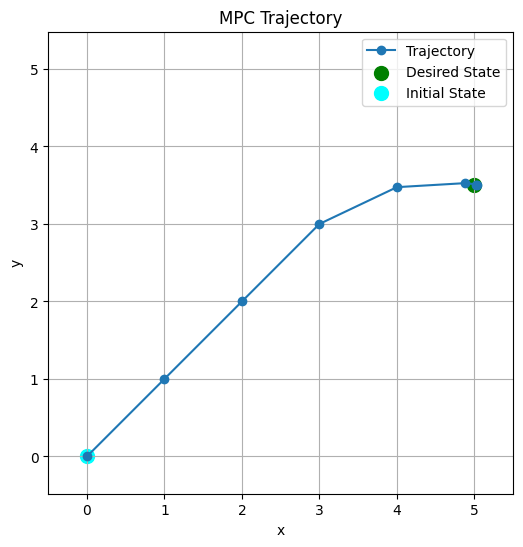

In [15]:
# ----------------- Plot trajectory -----------------
x_desired, y_desired = 5.0, 3.5
trajectory = np.array(trajectory)
plt.figure(figsize=(6,6))
plt.plot(trajectory[:,0], trajectory[:,1], 'o-', label='Trajectory')
plt.scatter(x_desired, y_desired, color='g', marker='o', s=100, label='Desired State')
plt.scatter(p0[0], p0[1], color='cyan', marker='o', s=100, label='Initial State')


plt.xlabel('x')
plt.ylabel('y')
plt.title('MPC Trajectory')
plt.legend()
plt.grid(True)
plt.axis('equal')
plt.axis([-0.5, 5.5, -0.5, 5.5])
plt.show()

Now, let us add boundary conditions for the states and rerun the controller.

In [16]:
# State Constraints (Bounds)
mpc = defineMPC(model, ts, N)
mpc.bounds['lower','_x','x'] = -2.0
mpc.bounds['upper','_x','x'] =  2.0
mpc.bounds['lower','_x','y'] = -2.0
mpc.bounds['upper','_x','y'] =  2.0
mpc.bounds['lower','_u','vx'] = -1.0
mpc.bounds['upper','_u','vx'] =  1.0
mpc.bounds['lower','_u','vy'] = -1.0
mpc.bounds['upper','_u','vy'] =  1.0


mpc.setup()
p0 = np.array([0.0, 0.0])
trajectory = [p0.copy()] # Log the position for plotting.
p = p0.copy()
run_mpc(mpc, p)

Streaming output truncated to the last 5000 lines.

Number of objective function evaluations             = 7
Number of objective gradient evaluations             = 7
Number of equality constraint evaluations            = 7
Number of inequality constraint evaluations          = 0
Number of equality constraint Jacobian evaluations   = 7
Number of inequality constraint Jacobian evaluations = 0
Number of Lagrangian Hessian evaluations             = 6
Total seconds in IPOPT                               = 0.026

EXIT: Optimal Solution Found.
           S  :   t_proc      (avg)   t_wall      (avg)    n_eval
       nlp_f  |  40.00us (  5.71us)  38.89us (  5.56us)         7
       nlp_g  | 159.00us ( 22.71us) 135.54us ( 19.36us)         7
  nlp_grad_f  |  64.00us (  8.00us)  62.71us (  7.84us)         8
  nlp_hess_l  |  37.00us (  6.17us)  37.21us (  6.20us)         6
   nlp_jac_g  |  98.00us ( 12.25us)  98.20us ( 12.28us)         8
       total  |  24.95ms ( 24.95ms)  27.23ms ( 27.23ms)      

In [17]:
print(np.array(trajectory))

[[0.         0.        ]
 [1.00000001 1.00000001]
 [2.00000002 2.00000002]
 [2.00000002 2.00000002]
 [2.00000002 2.00000002]
 [2.00000002 2.00000002]
 [2.00000002 2.00000002]
 [2.00000002 2.00000002]
 [2.00000002 2.00000002]
 [2.00000002 2.00000002]
 [2.00000002 2.00000002]
 [2.00000002 2.00000002]
 [2.00000002 2.00000002]
 [2.00000002 2.00000002]
 [2.00000002 2.00000002]
 [2.00000002 2.00000002]
 [2.00000002 2.00000002]
 [2.00000002 2.00000002]
 [2.00000002 2.00000002]
 [2.00000002 2.00000002]
 [2.00000002 2.00000002]
 [2.00000002 2.00000002]
 [2.00000002 2.00000002]
 [2.00000002 2.00000002]
 [2.00000002 2.00000002]
 [2.00000002 2.00000002]
 [2.00000002 2.00000002]
 [2.00000002 2.00000002]
 [2.00000002 2.00000002]
 [2.00000002 2.00000002]
 [2.00000002 2.00000002]
 [2.00000002 2.00000002]
 [2.00000002 2.00000002]
 [2.00000002 2.00000002]
 [2.00000002 2.00000002]
 [2.00000002 2.00000002]
 [2.00000002 2.00000002]
 [2.00000002 2.00000002]
 [2.00000002 2.00000002]
 [2.00000002 2.00000002]


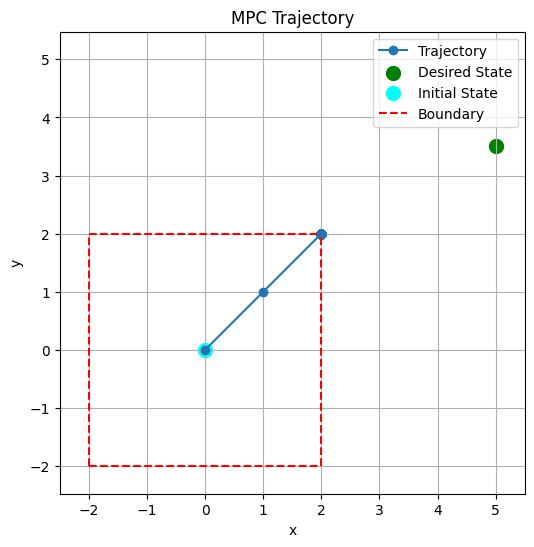

In [18]:
# ----------------- Plot trajectory -----------------
trajectory = np.array(trajectory)
plt.figure(figsize=(6,6))
plt.plot(trajectory[:,0], trajectory[:,1], 'o-', label='Trajectory')
plt.scatter(x_desired, y_desired, color='g', marker='o', s=100, label='Desired State')
plt.scatter(p0[0], p0[1], color='cyan', marker='o', s=100, label='Initial State')
plt.plot([-2.0, 2.0], [2.0, 2.0], color='red', linestyle='--', label='Boundary')
plt.plot([-2.0, 2.0], [-2.0, -2.0], color='red', linestyle='--')
plt.plot([2.0, 2.0], [-2.0, 2.0], color='red', linestyle='--')
plt.plot([-2.0, -2.0], [-2.0, 2.0], color='red', linestyle='--')


plt.xlabel('x')
plt.ylabel('y')
plt.title('MPC Trajectory')
plt.legend()
plt.grid(True)
plt.axis('equal')
plt.axis([-2.5, 5.5, -2.5, 5.5])
plt.show()

Due to the boundary, the robot's states are restricted. Now, let us increase the boundaries but add a nonlinear constraint to avoid a circular obstacle of radius $0.5 \text{m}$ placed at the position $(2.0, 2.0)$.

**NOTE:** We must reinitialize the mpc model to include the nonlinear constraint because it must be carried out before the setup.

In [19]:
# ----------------- Setup MPC -----------------
ts = 1
N = 20
mpc = defineMPC(model, ts, N)
# Bounds
mpc.bounds['lower','_x','x'] = -6.0
mpc.bounds['upper','_x','x'] =  6.0
mpc.bounds['lower','_x','y'] = -6.0
mpc.bounds['upper','_x','y'] =  6.0
mpc.bounds['lower','_u','vx'] = -1.0
mpc.bounds['upper','_u','vx'] =  1.0
mpc.bounds['lower','_u','vy'] = -1.0
mpc.bounds['upper','_u','vy'] =  1.0


# Nonlinear constraint
x_obs1 = 2.0
y_obs1 = 2.0
r_obs1 = 0.5
mpc.set_nl_cons(
    'obs1',
    r_obs1**2 - ((model.x['x']-x_obs1)**2 + (model.x['y']-y_obs1)**2),
    ub=0.0,
    soft_constraint=False   # <-- no penalty, enforced strictly
)

mpc.setup()
p0 = np.array([0.0, 0.0])
trajectory = [p0.copy()] # Log the position for plotting.
p = p0.copy()
run_mpc(mpc, p)

This is Ipopt version 3.14.11, running with linear solver MUMPS 5.4.1.

Number of nonzeros in equality constraint Jacobian...:      482
Number of nonzeros in inequality constraint Jacobian.:       40
Number of nonzeros in Lagrangian Hessian.............:      120

Total number of variables............................:      208
                     variables with only lower bounds:        0
                variables with lower and upper bounds:      192
                     variables with only upper bounds:        0
Total number of equality constraints.................:      162
Total number of inequality constraints...............:       20
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:       20

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  7.8225000e+02 0.00e+00 2.54e+00  -1.0 0.00e+00    -  0.00e+00 0.00e+00 

In [20]:
print(np.array(trajectory))

[[0.         0.        ]
 [1.00000001 1.00000001]
 [2.00000002 1.50000001]
 [3.00000003 2.50000002]
 [4.00000004 3.38330349]
 [4.88330349 3.53750415]
 [5.03750414 3.5171607 ]
 [5.01716069 3.50179035]]


Let us plot it.

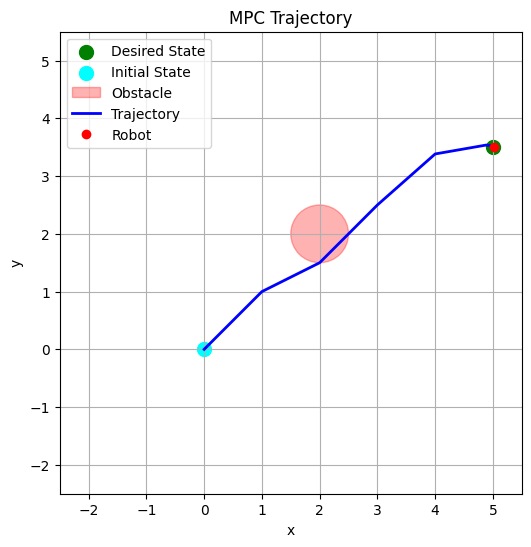

In [21]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

def animate_trajectory(trajectory, x_desired, y_desired, p0,
                       x_obs, y_obs, r_obs,
                       xlim=(-2.5, 5.5), ylim=(-2.5, 5.5),
                       interval=100):
    """
    Animate MPC trajectory with goal, initial state, and obstacle.

    Parameters
    ----------
    trajectory : array-like, shape (N,2)
        Sequence of [x,y] positions.
    x_desired, y_desired : float
        Desired (goal) position.
    p0 : array-like, shape (2,)
        Initial state [x,y].
    x_obs, y_obs : float
        Obstacle center.
    r_obs : float
        Obstacle radius.
    xlim, ylim : tuple
        Axes limits.
    interval : int
        Frame update interval in ms.
    """
    trajectory = np.array(trajectory)
    x_traj, y_traj = trajectory[:,0], trajectory[:,1]

    fig, ax = plt.subplots(figsize=(6,6))

    # Static elements
    ax.set_xlabel('x')
    ax.set_ylabel('y')
    ax.set_title('MPC Trajectory')
    ax.grid(True)
    ax.set_aspect('equal')
    ax.set_xlim(xlim)
    ax.set_ylim(ylim)

    # Goal and initial state
    ax.scatter(x_desired, y_desired, color='g', marker='o', s=100, label='Desired State')
    ax.scatter(p0[0], p0[1], color='cyan', marker='o', s=100, label='Initial State')

    circle = []

    for i in range(len(x_obs)):
      # Obstacle
      if i == 0:
        circle.append(plt.Circle((x_obs[i], y_obs[i]), r_obs[i], color='r', alpha=0.3, label='Obstacle'))
      else:
        circle.append(plt.Circle((x_obs[i], y_obs[i]), r_obs[i], color='r', alpha=0.3))
      ax.add_patch(circle[i])

    # Dynamic trajectory and robot
    line, = ax.plot([], [], 'b-', lw=2, label='Trajectory')
    point, = ax.plot([], [], 'ro', markersize=6, label='Robot')

    ax.legend()

    # Init + update
    def init():
        line.set_data([], [])
        point.set_data([], [])
        return line, point

    def update(frame):
        line.set_data(x_traj[:frame+1], y_traj[:frame+1])
        point.set_data([x_traj[frame]], [y_traj[frame]])
        return line, point

    ani = animation.FuncAnimation(
        fig, update, frames=len(x_traj),
        init_func=init, blit=True, interval=interval, repeat=False
    )

    return HTML(ani.to_jshtml())
animate_trajectory(
    trajectory,
    x_desired, y_desired,
    p0,
    [x_obs1], [y_obs1], [r_obs1]
)

***OOPS***

The robot passes through the obstacle.

But if you have noticed, the points on the trajectory are actually outside (or on the boundary of) the circle. Let us decrease the sampling time and test again.

In [22]:
# ----------------- Setup MPC -----------------
ts = 0.1
N = 20
mpc = defineMPC(model, ts, N)

# Bounds
mpc.bounds['lower','_x','x'] = -6.0
mpc.bounds['upper','_x','x'] =  6.0
mpc.bounds['lower','_x','y'] = -6.0
mpc.bounds['upper','_x','y'] =  6.0
mpc.bounds['lower','_u','vx'] = -1.0
mpc.bounds['upper','_u','vx'] =  1.0
mpc.bounds['lower','_u','vy'] = -1.0
mpc.bounds['upper','_u','vy'] =  1.0


# Nonlinear constraint
x_obs1 = 2.0
y_obs1 = 2.0
r_obs1 = 0.5
mpc.set_nl_cons(
    'obs1',
    r_obs1**2 - ((model.x['x']-x_obs1)**2 + (model.x['y']-y_obs1)**2),
    ub=0.0,
    soft_constraint=False   # <-- no penalty, enforced strictly
)

mpc.setup()
# ----------------- Simulation Loop -----------------
n_steps = 100  # Hard stop point (in case the robot never reaches the goal)

p0 = np.array([0.0, 0.0])
p = p0.copy()
trajectory = [p0.copy()] # Log the position for plotting.

run_mpc(mpc, p)

This is Ipopt version 3.14.11, running with linear solver MUMPS 5.4.1.

Number of nonzeros in equality constraint Jacobian...:      482
Number of nonzeros in inequality constraint Jacobian.:       40
Number of nonzeros in Lagrangian Hessian.............:      120

Total number of variables............................:      208
                     variables with only lower bounds:        0
                variables with lower and upper bounds:      192
                     variables with only upper bounds:        0
Total number of equality constraints.................:      162
Total number of inequality constraints...............:       20
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:       20

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  7.8225000e+02 0.00e+00 1.75e+00  -1.0 0.00e+00    -  0.00e+00 0.00e+00 

In [23]:
print(np.array(trajectory))

[[0.         0.        ]
 [0.1        0.1       ]
 [0.2        0.2       ]
 [0.3        0.3       ]
 [0.4        0.4       ]
 [0.5        0.5       ]
 [0.60000001 0.60000001]
 [0.70000001 0.70000001]
 [0.80000001 0.80000001]
 [0.90000001 0.90000001]
 [1.00000001 1.00000001]
 [1.10000001 1.10000001]
 [1.20000001 1.20000001]
 [1.30000001 1.30000001]
 [1.40000001 1.40000001]
 [1.50000001 1.50000001]
 [1.60000002 1.60000001]
 [1.70000002 1.6       ]
 [1.80000002 1.54174243]
 [1.90000002 1.51010206]
 [2.00000002 1.50000001]
 [2.10000002 1.51010207]
 [2.20000002 1.54174245]
 [2.30000002 1.60000003]
 [2.40000002 1.70000003]
 [2.50000002 1.80000003]
 [2.60000003 1.90000003]
 [2.70000003 2.00000003]
 [2.80000003 2.10000003]
 [2.90000003 2.20000003]
 [3.00000003 2.30000004]
 [3.10000003 2.40000004]
 [3.20000003 2.50000004]
 [3.30000003 2.60000004]
 [3.40000003 2.70000004]
 [3.50000003 2.80000004]
 [3.60000003 2.90000004]
 [3.70000004 3.00000004]
 [3.80000004 3.10000004]
 [3.90000004 3.20000004]


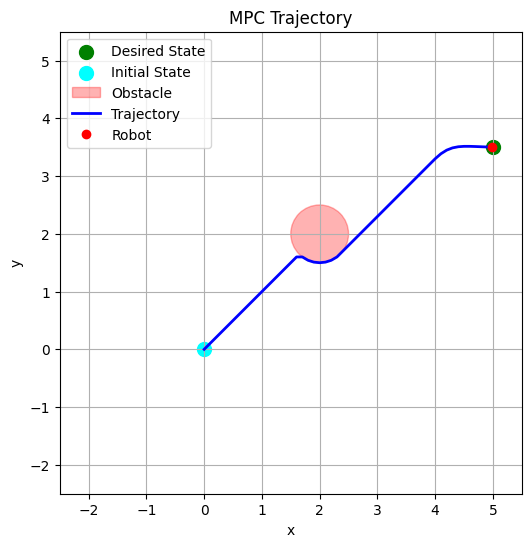

In [24]:
animate_trajectory(
    trajectory,
    x_desired, y_desired,
    p0,
    [x_obs1], [y_obs1], [r_obs1]
)

Now, (almost) all the points avoid it.

Good, then!!!

# Turtlebot Control
Let us move to the actual problem of a turtlebot robot (`Turtlebot3 Burger` [link text](https://emanual.robotis.com/docs/en/platform/turtlebot3/features/)), which uses a differential drive model for its control.

![Turtlebot3 Burger](https://emanual.robotis.com/assets/images/platform/turtlebot3/hardware_setup/turtlebot3_burger_components.png)

However, since we do not consider the wheel dynamics in our control design, we use the higher-level kinematic model for the states $(x, y, \theta)$ (pose in inertial frame) and the control inputs in body frame $(v, \omega)$, given by,

$$
\begin{bmatrix}
\dot x \\[4pt]
\dot y \\[4pt]
\dot \theta
\end{bmatrix}
=
\begin{bmatrix}
\cos\theta & 0 \\[4pt]
\sin\theta & 0 \\[4pt]
0 & 1
\end{bmatrix}
\begin{bmatrix}
v \\[4pt]
\omega
\end{bmatrix}
$$

![Simplified Dynamics](https://www.researchgate.net/publication/277914310/figure/fig10/AS:1088594546565141@1636552573165/Kinematic-model-of-the-unicycle-type-mobile-robot.jpg)

Interested people may also check [`Near Identity Diffeomorphism`](https://liwanggt.github.io/files/Robotarium_CSM_Impact.pdf), used for linearizing the unicycle model. However, since `do_mpc` supports nonlinear models, we use the standard model.

Now, let us create a nonlinear model.

In [25]:
# ----------------- Define Model -----------------
def defineTBotModel():

  model_type = 'continuous'
  model = do_mpc.model.Model(model_type)

  # States
  x = model.set_variable(var_type='_x', var_name='x', shape=(1,1))
  y = model.set_variable(var_type='_x', var_name='y', shape=(1,1))
  th = model.set_variable(var_type='_x', var_name='th', shape=(1,1))

  # Inputs
  vx = model.set_variable(var_type='_u', var_name='vx')
  vt = model.set_variable(var_type='_u', var_name='vt')

  # Dynamics
  model.set_rhs('x', vx*ca.cos(th))
  model.set_rhs('y', vx*ca.sin(th))
  model.set_rhs('th', vt)

  return model


In [26]:

# ----------------- Setup MPC -----------------
def defineTBotMPC(model, ts, N):
  mpc = do_mpc.controller.MPC(model)
  setup_mpc = {
      'n_horizon': N,
      't_step': ts,
      'n_robust': 1,
      'store_full_solution': True
  }
  mpc.set_param(**setup_mpc)

  # Objective
  x_desired = 2.0
  y_desired = 0.0
  mterm = (model.x['x']-x_desired)**2 + (model.x['y']-y_desired)**2
  lterm = (model.x['x']-x_desired)**2 + (model.x['y']-y_desired)**2
  mpc.set_objective(mterm=mterm, lterm=lterm)
  mpc.set_rterm(vx=1e-2, vt=1e-2)

  # State Bounds
  mpc.bounds['lower','_x','x'] = -2.0
  mpc.bounds['upper','_x','x'] =  2.0
  mpc.bounds['lower','_x','y'] = -2.0
  mpc.bounds['upper','_x','y'] =  2.0

  # Input Constraints
  mpc.bounds['lower','_u','vx'] = 0.0
  mpc.bounds['upper','_u','vx'] =  0.8
  mpc.bounds['lower','_u','vt'] = -0.8
  mpc.bounds['upper','_u','vt'] =  0.8

  # Nonlinear Constraint for Obstacle 1
  x_obs1 = 0.5
  y_obs1 = 0.1
  r_obs1 = 0.2
  mpc.set_nl_cons(
      'obs1',
      r_obs1**2 - ((model.x['x']-x_obs1)**2 + (model.x['y']-y_obs1)**2),
      ub=0.0,
      soft_constraint=False   # <-- no penalty, enforced strictly
  )

  # Nonlinear Constraint for Obstacle 2
  x_obs2 = 1.4
  y_obs2 = -0.3
  r_obs2 = 0.3
  mpc.set_nl_cons(
      'obs2',
      r_obs2**2 - ((model.x['x']-x_obs2)**2 + (model.x['y']-y_obs2)**2),
      ub=0.0,
      soft_constraint=False   # <-- no penalty, enforced strictly
  )

  return mpc

tbModel = defineTBotModel()
tbModel.setup()
tbMpc = defineTBotMPC(tbModel, ts, N)
tbMpc.setup()


In [27]:
# Initial state
p0 = np.array([0.0, 0.0, 0.0])
tbMpc.x0 = p0
tbMpc.set_initial_guess()
#----------- Simulation Loop -----------------
n_steps = 100
p = p0.copy()
trajectory = [p0.copy()]

def run_tbMpc(mpc_, p):
  mpc_.x0 = p
  mpc_.set_initial_guess()

  for i in range(n_steps):
      # Print current state
      u = mpc_.make_step(p)

      # Update state
      p = p + ts*np.array([u[0,0]*np.cos(p[2]), u[0,0]*np.sin(p[2]), u[1,0]])
      mpc_.x0 = p

      # Store trajectory
      trajectory.append(p.copy())

      # Termination condition
      if np.linalg.norm(np.array([x_desired-p[0], y_desired-p[1]])) < 0.02:
          break

run_tbMpc(tbMpc, p)


Streaming output truncated to the last 5000 lines.
Constraint violation....:   5.3148589695961590e-11    5.3148589695961590e-11
Variable bound violation:   1.6503148625446329e-08    1.6503148625446329e-08
Complementarity.........:   6.5687445952656272e-09    6.5687445952656272e-09
Overall NLP error.......:   6.5687445952656272e-09    6.5687445952656272e-09


Number of objective function evaluations             = 16
Number of objective gradient evaluations             = 16
Number of equality constraint evaluations            = 16
Number of inequality constraint evaluations          = 16
Number of equality constraint Jacobian evaluations   = 16
Number of inequality constraint Jacobian evaluations = 16
Number of Lagrangian Hessian evaluations             = 15
Total seconds in IPOPT                               = 0.072

EXIT: Optimal Solution Found.
           S  :   t_proc      (avg)   t_wall      (avg)    n_eval
       nlp_f  | 104.00us (  6.50us)  97.01us (  6.06us)        16
       nl

In [28]:
print(np.array(trajectory))

[[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 8.00000009e-02  0.00000000e+00 -8.00000004e-02]
 [ 1.59744138e-01 -6.39317563e-03 -1.60000001e-01]
 [ 2.38722322e-01 -1.91386324e-02 -2.40000002e-01]
 [ 3.16429361e-01 -3.81548429e-02 -3.20000003e-01]
 [ 3.24910523e-01 -4.09654101e-02 -4.00000003e-01]
 [ 3.96614694e-01 -7.12814476e-02 -3.98321714e-01]
 [ 4.70351755e-01 -1.02311207e-01 -3.18321713e-01]
 [ 5.46332717e-01 -1.27349050e-01 -2.38321713e-01]
 [ 6.24071561e-01 -1.46234819e-01 -1.58321712e-01]
 [ 7.01087028e-01 -1.58530949e-01 -7.83217108e-02]
 [ 7.75813850e-01 -1.64395678e-01  1.67829008e-03]
 [ 8.51371941e-01 -1.64268870e-01  8.16782909e-02]
 [ 9.25620663e-01 -1.58190839e-01  1.61678292e-01]
 [ 9.98339870e-01 -1.46330196e-01  2.41678293e-01]
 [ 1.06378536e+00 -1.30198129e-01  3.21678294e-01]
 [ 1.10832992e+00 -1.15353519e-01  4.01678294e-01]
 [ 1.16529752e+00 -9.11552226e-02  4.81678295e-01]
 [ 1.22062643e+00 -6.22322630e-02  5.51592741e-01]
 [ 1.28075414e+00 -2.52357578e-

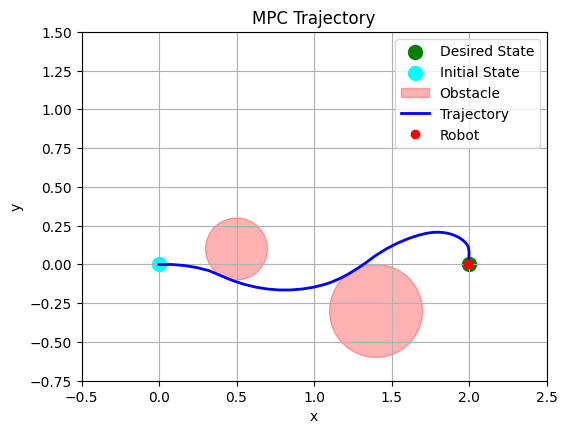

In [29]:

  # Nonlinear Constraint for Obstacle 1
  x_obs1 = 0.5
  y_obs1 = 0.1
  r_obs1 = 0.2

  # Nonlinear Constraint for Obstacle 2
  x_obs2 = 1.4
  y_obs2 = -0.3
  r_obs2 = 0.3

  x_desired, y_desired = 2.0, 0.0
  animate_trajectory(trajectory, x_desired, y_desired, p0, [x_obs1, x_obs2], [y_obs1, y_obs2], [r_obs1, r_obs2], xlim=(-0.5, 2.5), ylim=(-0.75, 1.5))


### Dynamic Setpoint:
Now, let us modify the model to use dynamic setpoints instead of tracking only the current setpoint.

In [30]:
tbModel = defineTBotModel()

# Time-varying Parameters (Used to set values in the run-time)
xdes = tbModel.set_variable(var_type='_tvp', var_name='xdes', shape=(1,1))
ydes = tbModel.set_variable(var_type='_tvp', var_name='ydes', shape=(1,1))

tbModel.setup()


In [31]:
tbMpc = defineTBotMPC(tbModel, ts, 20)

# Cost (Use the TVPs)
lterm = (tbModel.x['x'] - tbModel.tvp['xdes'])**2 + (tbModel.x['y'] - tbModel.tvp['ydes'])**2
mterm = lterm
tbMpc.set_objective(mterm=mterm, lterm=lterm)

# Get a template of the TVPs inside the MPC
tvp = tbMpc.get_tvp_template()

# Initialize the TVPs inside MPC
tvp_fun = lambda t_now: tvp
tbMpc.set_tvp_fun(tvp_fun)
tbMpc.setup()

In [32]:
# TVP template gives an array of size [N+1 x 2]
# Set the values over the horizon for checking

for k in range(N+1):
  tvp['_tvp',k,'xdes'] = 1.0
  tvp['_tvp',k,'ydes'] = 0.0

In [34]:
# Run the simulation
p0 = np.array([0.0, 0.0, 0.0])
tbMpc.x0 = p0
tbMpc.set_initial_guess()
p = p0.copy()
trajectory = [p0.copy()]

for i in range(n_steps*3):
  # For every step of the simulation, update the values of the desired setpoints.
  for k in range(len(tvp['_tvp'])):
    tvp['_tvp',k,'xdes'] = 1.0 + 1.0*np.cos(2*np.pi*(i+k)/n_steps)
    tvp['_tvp',k,'ydes'] = 1.0 + 1.0*np.sin(2*np.pi*(i+k)/n_steps)
  # tvp = tvp_template
  # Print current state
  u = tbMpc.make_step(p)

  # Update state
  p = p + ts*np.array([u[0,0]*np.cos(p[2]), u[0,0]*np.sin(p[2]), u[1,0]])
  tbMpc.x0 = p

  # Store trajectory
  trajectory.append(p.copy())

  # Termination condition
  if np.linalg.norm(np.array([x_desired-p[0], y_desired-p[1]])) < 0.02:
    break
print(u)

Streaming output truncated to the last 5000 lines.
  27r 6.0953926e-02 6.99e-05 4.26e-06  -6.2 9.74e-04    -  1.00e+00 1.00e+00f  1
  28r 6.0857658e-02 6.99e-05 4.06e-05  -9.0 4.04e-04    -  9.97e-01 1.00e+00h  1

Number of Iterations....: 28

                                   (scaled)                 (unscaled)
Objective...............:   6.0856367252049730e-02    6.0856367252049730e-02
Dual infeasibility......:   1.6621488932111447e-01    1.6621488932111447e-01
Constraint violation....:   6.9871226904272277e-05    6.9871226904272277e-05
Variable bound violation:   1.9999090827838018e-08    1.9999090827838018e-08
Complementarity.........:   9.1048856528435899e-10    9.1048856528435899e-10
Overall NLP error.......:   1.6621488932111447e-01    1.6621488932111447e-01


Number of objective function evaluations             = 41
Number of objective gradient evaluations             = 23
Number of equality constraint evaluations            = 41
Number of inequality constraint evaluations    

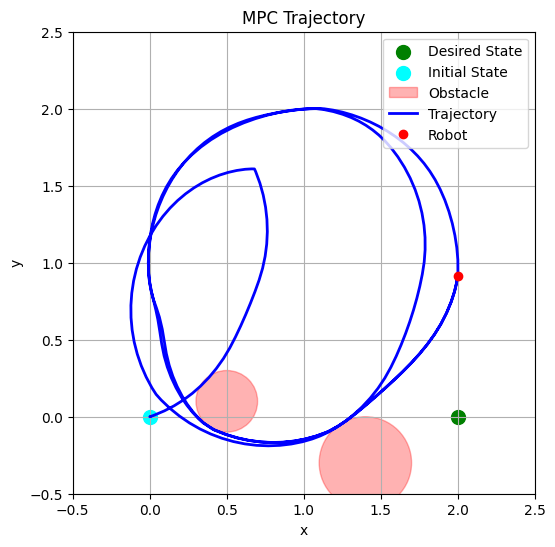

In [35]:
animate_trajectory(trajectory, x_desired, y_desired, p0, [x_obs1, x_obs2], [y_obs1, y_obs2], [r_obs1, r_obs2], xlim=(-0.5, 2.5), ylim=(-0.5, 2.5))

## Well Done!!!!


# ROS2 Implementation
Now implement a ROS2 Node that subscribes to the `/odom` topic and publishes `/cmd_vel` topic and uses this MPC.

## List of Tasks:
### 1. Setpoint Tracking
a. Implement a setpoint tracking controller with the following constraints:

*Input Constraints:*
$$
0 < v_x < 0.5, ~
-0.8 < v_t < 0.8,
$$
*Boundary Constraints:*
$$
-1.0 < x < 1.0, ~
-1.0 < y < 1.0.
$$
b. Choose a setpoint inside the boundary and outside the boundary to verify the controller.

### 2. Obstacle Avoidance
a. Add an obstacle avoidance constraint to the controller to avoid a static obstacle.

**NOTE:** Adjust the boundary constraints if necessary.

### 3. Multi-Obstacle Avoidance
a. Add at least two obstacle avoidance constraints to the controller.

### 4. Trajectory Tracking
a. Make the robot move in a circular trajectory while avoiding at least one static obstacle.

***Please record the rosbags and videos for the report.***